## Import neccesary Libraries

In [2]:
import torch
from torch import nn, optim
from collections import OrderedDict
import numpy as np
import matplotlib.pyplot as plt
from torchinfo import summary
import pandas as pd
from torchvision import datasets
import os
from torch.utils.data import Dataset, DataLoader
from tqdm.notebook import tqdm_notebook
from sklearn.metrics import confusion_matrix, accuracy_score
from torchvision import models, transforms, utils
import os
import torchvision
from zipfile import ZipFile

## let's create a dataset and dataloader from train_dataset and test_dataset file
* ### there are three classes in the dataset file and the classes are human, dog, cats
* ### each classes have 1024 images in train dataset and 256 images in test dataset

In [ ]:
# loading the temp.zip and creating a zip object
with ZipFile("/content/train_datasets.zip", 'r') as zObject:
    # Extracting all the members of the zip
	# into a specific location.
	zObject.extractall(path="/content")
    
with ZipFile("/content/test_datasets.zip", 'r') as zObject:
    # Extracting all the members of the zip
	# into a specific location.
	zObject.extractall(path="/content")


files = os.listdir('/content')
print(files)

In [6]:
# Define transformations for the images (e.g., resizing, normalization)
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize images to 256x256 pixels
    transforms.ToTensor(),  # Convert images to PyTorch tensors
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalize images
])

# Load the dataset
train_data = datasets.ImageFolder(root="C:/Users/Raunak Gola/PyTorch_tut/train_data", transform=transform)
test_data = datasets.ImageFolder(root="C:/Users/Raunak Gola/PyTorch_tut/test_data", transform=transform)
# Create a DataLoader to iterate through the dataset
train_dataloader = DataLoader(train_data, batch_size=64, shuffle=True, num_workers=4)
test_dataloader = DataLoader(test_data, batch_size=64, shuffle=False, num_workers=4)

print(f'Class names: {train_data.classes}')

Class names: ['cat', 'dog', 'human']


In [9]:
BATCH_SIZE = 64

In [10]:
print(f"Length of training dataloader: {len(train_dataloader)} batches of {BATCH_SIZE}")
print(f"Length of testing dataloader: {len(test_dataloader)} batches of {BATCH_SIZE}")

Length of training dataloader: 72 batches of 64
Length of testing dataloader: 18 batches of 64


In [11]:
train_features, train_labels = next(iter(train_dataloader))
print(f"Feature batch shape: {train_features.size()}")
print(f"Labels batch shape: {train_labels.size()}")

Feature batch shape: torch.Size([64, 3, 256, 256])
Labels batch shape: torch.Size([64])


In [12]:
test_features, test_labels = next(iter(test_dataloader))
print(f"Feature batch shape: {test_features.size()}")
print(f"Labels batch shape: {test_labels.size()}")

Feature batch shape: torch.Size([64, 3, 256, 256])
Labels batch shape: torch.Size([64])


## lets see how the images looks like

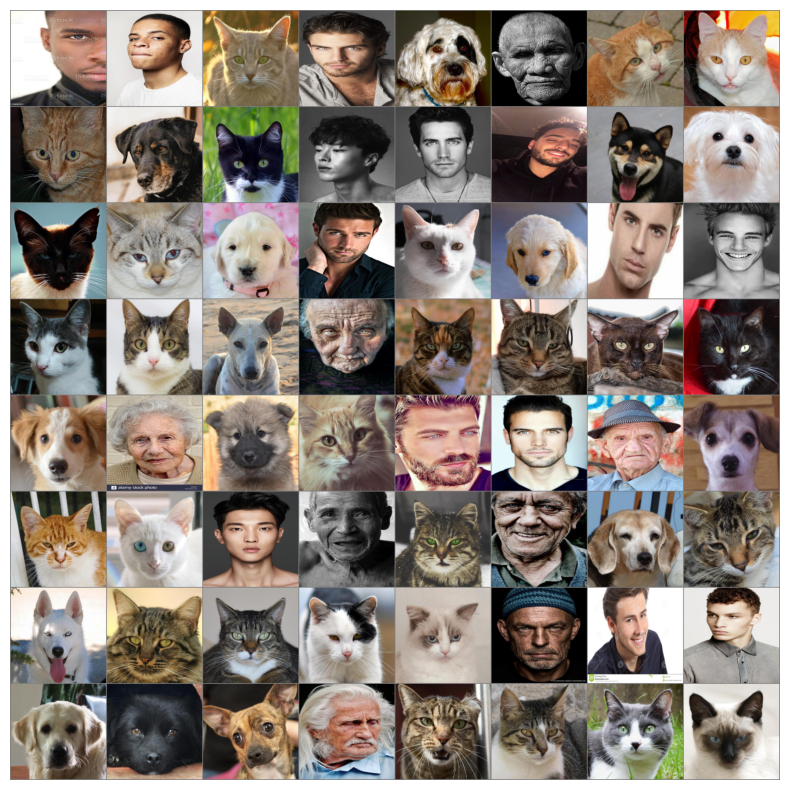

human human cat human dog human cat cat cat dog cat human human human dog dog cat cat dog human cat dog human human cat cat dog human cat cat cat cat dog human dog cat human human human dog cat cat human human cat human dog cat dog cat cat cat cat human human human dog dog dog human cat cat cat cat


In [14]:
#  Function to unnormalize and show an image
def imshow(img):
    img = (img *0.5) + 0.5  # unnormalize
    npimg = img.numpy()
    plt.figure(figsize=(10, 10))
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')
    plt.show()

# Get a batch of images and labels
dataiter = iter(train_dataloader)
images, labels = next(dataiter)

# Show images
imshow(torchvision.utils.make_grid(images))

# Print labels
print(' '.join(f'{train_data.classes[labels[j]]}' for j in range(len(labels))))

## Setting up Device Agnostic code

In [15]:
# Setup device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

Using device: cpu


## Creating the model

In [16]:
torch.manual_seed(5)
model = nn.Sequential(OrderedDict([('Conv1', nn.Conv2d(3,32,kernel_size=(3,3),padding=(1,1))),
                                    ('Conv2', nn.Conv2d(32,64,kernel_size=(3,3),padding=(1,1))),
                                    ('ReLU1', nn.ReLU()),
                                    ('MaxPool1',nn.MaxPool2d(kernel_size=(3,3),padding=(1,1))),
                                    ('Conv3',nn.Conv2d(64,64,kernel_size=(3,3),padding=(1,1))),
                                    ('Conv4',nn.Conv2d(64,64,kernel_size=(3,3),padding=(1,1))),
                                    ('ReLU2',nn.ReLU()),
                                    ('MaxPool2',nn.MaxPool2d(kernel_size=(3,3),padding=(1,1))),
                                    ('Conv5',nn.Conv2d(64,64,kernel_size=(3,3),padding=(1,1))),
                                    ('Conv6',nn.Conv2d(64,128,kernel_size=(3,3),padding=(1,1))),
                                    ('ReLU3',nn.ReLU()),
                                    ('MaxPool3',nn.MaxPool2d(kernel_size=(3,3),padding=(1,1))),
                                    ('Flatten',nn.Flatten()),
                                    ('Layer1',nn.Linear(12800,128)),
                                    ('ReLU3',nn.ReLU()),
                                    ('Layer2',nn.Linear(128,64)),
                                    ('ReLU4',nn.ReLU()),
                                    ('Layer3',nn.Linear(64,3))
                                   ])).to(device)

## model summary

In [17]:
summary(model, input_size=(1,3,256,256))

Layer (type:depth-idx)                   Output Shape              Param #
Sequential                               [1, 3]                    --
├─Conv2d: 1-1                            [1, 32, 256, 256]         896
├─Conv2d: 1-2                            [1, 64, 256, 256]         18,496
├─ReLU: 1-3                              [1, 64, 256, 256]         --
├─MaxPool2d: 1-4                         [1, 64, 86, 86]           --
├─Conv2d: 1-5                            [1, 64, 86, 86]           36,928
├─Conv2d: 1-6                            [1, 64, 86, 86]           36,928
├─ReLU: 1-7                              [1, 64, 86, 86]           --
├─MaxPool2d: 1-8                         [1, 64, 29, 29]           --
├─Conv2d: 1-9                            [1, 64, 29, 29]           36,928
├─Conv2d: 1-10                           [1, 128, 29, 29]          73,856
├─ReLU: 1-11                             [1, 128, 29, 29]          --
├─MaxPool2d: 1-12                        [1, 128, 10, 10]       

## Model State Dict

In [18]:
model.state_dict()['Conv1.weight'].shape

torch.Size([32, 3, 3, 3])

In [19]:
model.state_dict()['Conv2.weight'].shape

torch.Size([64, 32, 3, 3])

In [20]:
model.state_dict()['Conv3.weight'].shape

torch.Size([64, 64, 3, 3])

In [21]:
model.state_dict()['Conv4.weight'].shape

torch.Size([64, 64, 3, 3])

In [22]:
model.state_dict()['Conv5.weight'].shape

torch.Size([64, 64, 3, 3])

In [23]:
model.state_dict()['Conv6.weight'].shape

torch.Size([128, 64, 3, 3])

In [24]:
#model.state_dict()

## Early Stopping Code

In [25]:
class EarlyStopping:
    def __init__(self, patience=5, delta=0, restore_best_weights=True, path='checkpoint.pt', verbose=False):
        self.patience = patience
        self.delta = delta
        self.verbose = verbose
        self.restore_best_weights = restore_best_weights
        self.best_loss = None
        self.counter = 0
        self.path = path
        self.early_stop = False

    def __call__(self, val_loss, model):
        loss = val_loss

        if self.best_loss is None:
            self.best_loss = loss
            torch.save(model.state_dict(), self.path)
            # print("saved model1")
        elif loss - self.best_loss >=  self.delta:
            self.counter += 1
            if self.verbose:
                print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_loss = loss
            if self.restore_best_weights:
                torch.save(model.state_dict(), self.path)
            
            self.counter = 0

## Setting up Loss function and Optimizer

In [26]:
# Create loss function
criterion = nn.CrossEntropyLoss()

# Create optimizer
optimizer = torch.optim.Adam(params=model.parameters(), # optimize newly created model's parameters
                            lr=0.001)

## Training Loop

In [28]:
%%time
num_epochs = 15
trainloss = []
testloss = []
trainaccuracy = []
testaccuracy = []

## early stopping Instance
early_stopping = EarlyStopping(patience=10, verbose=True, delta = 0.001, path ="CNN_Classifier1.pt")
for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    running_train_loss = 0.0
    correct_train = 0
    
    for train_images, train_labels in train_dataloader:
        optimizer.zero_grad()  # Zero the parameter gradients
        outputs = model(train_images.to(device))  # Forward pass
        train_loss = criterion(outputs, train_labels.to(device))  # Compute loss
        train_loss.backward()  # Backward pass
        optimizer.step()  # Optimize
        
        _, train_pred = torch.max(outputs.data,dim=-1) # predicted labels 
        correct_train += torch.eq(train_pred.to(device),train_labels.to(device)).sum()

        running_train_loss += train_loss.item() 
        train_accuracy = 100*(correct_train/len(train_dataloader.dataset))

    avg_train_loss = running_train_loss / len(train_dataloader)
    
    # Set model to evaluation mode
    correct_test = 0
    running_test_loss = 0.0
    model.eval()
    with torch.no_grad():
        for test_images, test_labels in test_dataloader:
            test_outputs = model(test_images.to(device))
            test_loss = criterion(test_outputs, test_labels.to(device))
            _, test_pred = torch.max(test_outputs.data, 1)
            running_test_loss += test_loss.item()
            correct_test += torch.eq(test_pred.to(device),test_labels.to(device)).sum()
            test_accuracy = 100*(correct_test/len(test_dataloader.dataset))

    avg_test_loss = running_test_loss / len(test_dataloader)

    trainloss.append(avg_train_loss)
    testloss.append(avg_test_loss)
    testaccuracy.append(test_accuracy)
    trainaccuracy.append(train_accuracy)
    print(f'Epoch [{epoch + 1}/{num_epochs}]| Train Loss: {avg_train_loss:.4f}| Train Accuracy: {train_accuracy:.2f}%| Test loss: {avg_test_loss:.4f}| Test Accuracy: {test_accuracy:.2f}%')
    early_stopping(avg_test_loss, model)
    if early_stopping.early_stop:
        print("Early stopping")
        break

Epoch [1/15]| Train Loss: 0.6691| Train Accuracy: 70.16%| Test loss: 0.5425| Test Accuracy: 80.73%
Epoch [2/15]| Train Loss: 0.2316| Train Accuracy: 91.67%| Test loss: 0.2823| Test Accuracy: 90.45%
Epoch [3/15]| Train Loss: 0.1060| Train Accuracy: 95.90%| Test loss: 0.2643| Test Accuracy: 92.62%
Epoch [4/15]| Train Loss: 0.0638| Train Accuracy: 97.66%| Test loss: 0.2697| Test Accuracy: 91.67%
EarlyStopping counter: 1 out of 10
Epoch [5/15]| Train Loss: 0.0640| Train Accuracy: 97.59%| Test loss: 0.4419| Test Accuracy: 89.32%
EarlyStopping counter: 2 out of 10
Epoch [6/15]| Train Loss: 0.0653| Train Accuracy: 98.03%| Test loss: 0.2799| Test Accuracy: 91.67%
EarlyStopping counter: 3 out of 10
Epoch [7/15]| Train Loss: 0.0318| Train Accuracy: 98.83%| Test loss: 0.3585| Test Accuracy: 91.15%
EarlyStopping counter: 4 out of 10
Epoch [8/15]| Train Loss: 0.0211| Train Accuracy: 99.24%| Test loss: 0.2093| Test Accuracy: 94.79%
Epoch [9/15]| Train Loss: 0.0163| Train Accuracy: 99.50%| Test loss:

## Accuracy and Loss Curves

In [9]:
e = []
for i in range(1,16):
    e.append(i)

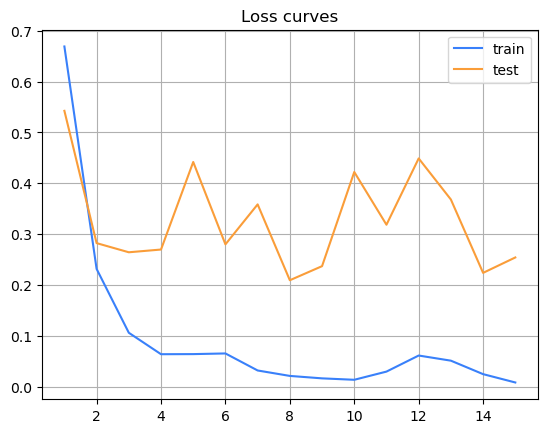

In [12]:
plt.grid()
plt.plot(e,trainloss,color='#3980fa')
plt.plot(e,testloss,color='#fa9d39')
plt.title('Loss curves')
plt.legend(['train','test'])
plt.show()

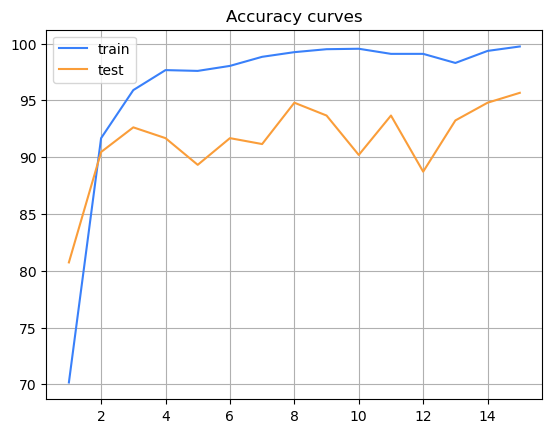

In [10]:
plt.grid()
plt.plot(e,trainaccuracy,color='#3980fa')
plt.plot(e,testaccuracy,color='#fa9d39')
plt.title('Accuracy curves')
plt.legend(['train','test'])
plt.show()

## evaluate the model

In [33]:
correct_test = 0
actual = []
predicted = []
model.eval()  # Set model to evaluation mode
with torch.no_grad():
    for test_images, test_labels in test_dataloader:
        test_outputs = model(test_images.to(device))
        test_loss = criterion(test_outputs, test_labels.to(device))
        _, test_pred = torch.max(test_outputs.data, 1)
        running_test_loss += test_loss.item()
        
        correct_test += torch.eq(test_pred.to(device),test_labels.to(device)).sum() # how many of them are correct 
        predicted += test_pred.tolist() #store predicted labels to list
        actual += test_labels.tolist() # store actual labels to list


In [34]:
cm = confusion_matrix(actual,predicted)

The Acuuracy of the model is:  95.66


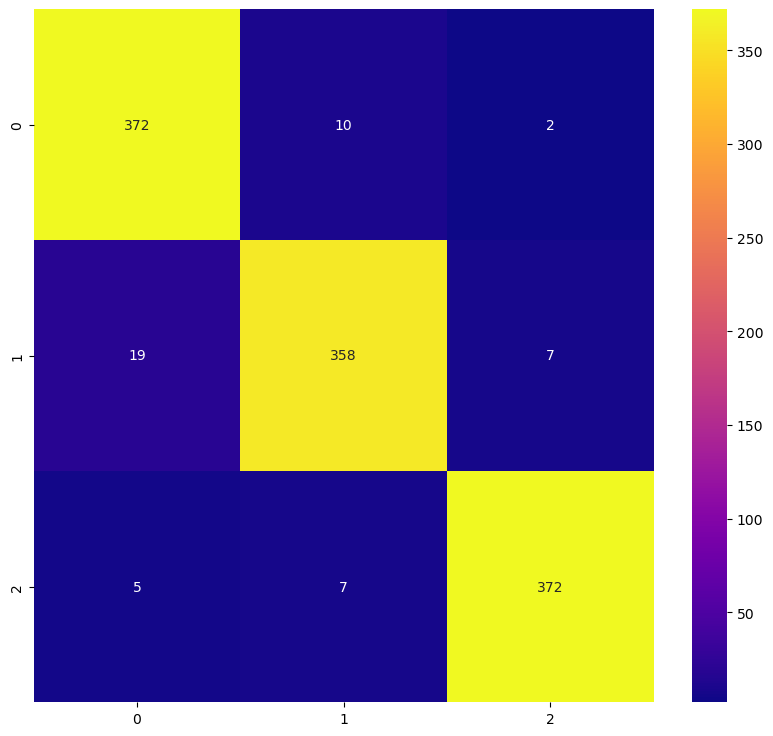

In [35]:
plt.figure(figsize=(10,9))
sns.heatmap(cm,cmap="plasma",annot=True,fmt='.5g')
print("The Acuuracy of the model is: ",round(accuracy_score(actual,predicted)*100,3)) 
# here 0 , 1, 2, represents cat, dog, human respectively

## make some prediction

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The predicted Class is:  0


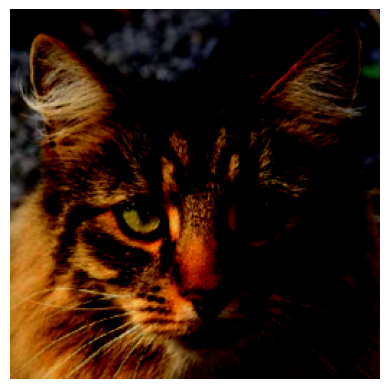

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The predicted Class is:  2


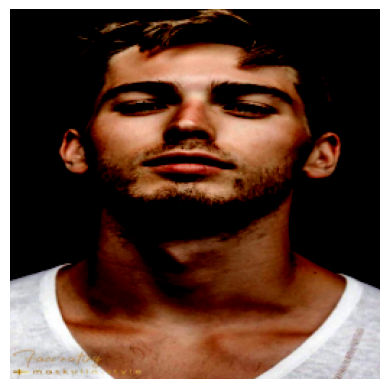

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The predicted Class is:  0


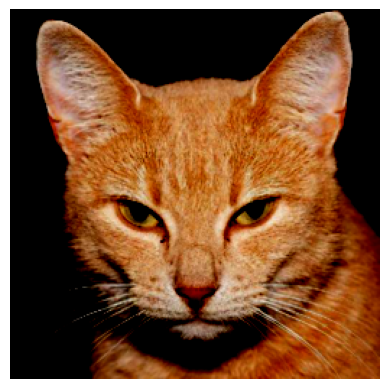

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The predicted Class is:  2


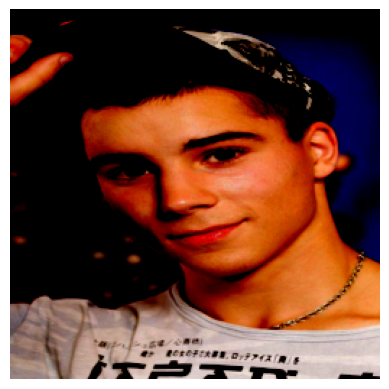

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The predicted Class is:  1


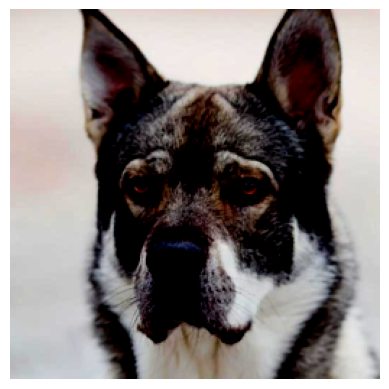

In [38]:
model.eval()  # Set model to evaluation mode
with torch.no_grad():
    for test_images, test_labels in train_dataloader:
        for i in range(0,5):
            test_outputs = model(test_images[0:i+1].to(device))
            _, test_pred = torch.max(test_outputs.data, 1)
            # print predicted labels and image of it. 
            print("The predicted Class is: ",int(test_pred[i:i+1]))
            plt.imshow(test_images[i:i+1].reshape(3,256,256).permute(1,2,0).numpy(),cmap="grey")
            plt.axis('off')
            plt.show()
    
        break
    

## Visualise the Model

In [39]:
torch_input = torch.randn(1,3,256,256)
torch_input.shape

torch.Size([1, 3, 256, 256])

In [40]:
import onnx
torch.onnx.export(model, torch_input,"CNN2.onnx")

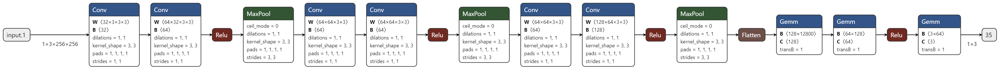

In [41]:
#  this is the model looks like 
from IPython.display import Image
Image(filename="C:/Users/Raunak Gola/Downloads/CNN_architecture2.png")

## Visualize the filter map of CNN

In [42]:
list(model.children())

[Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(),
 MaxPool2d(kernel_size=(3, 3), stride=(3, 3), padding=(1, 1), dilation=1, ceil_mode=False),
 Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(),
 MaxPool2d(kernel_size=(3, 3), stride=(3, 3), padding=(1, 1), dilation=1, ceil_mode=False),
 Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
 ReLU(),
 MaxPool2d(kernel_size=(3, 3), stride=(3, 3), padding=(1, 1), dilation=1, ceil_mode=False),
 Flatten(start_dim=1, end_dim=-1),
 Linear(in_features=12800, out_features=128, bias=True),
 Linear(in_features=128, out_features=64, bias=True),
 ReLU(),
 Linear(in_features=64, out_features=3, bias=True)]

In [43]:

# we will save the conv layer weights in this list
model_weights =[]
#we will save the 49 conv layers in this list
conv_layers = []
# get all the model children as list
model_children = list(model.children())
#counter to keep count of the conv layers
counter = 0
#append all the conv layers and their respective wights to the list
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:4
        counter+=1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter+=1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"Total convolution layers: {counter}")
print("conv_layers")

Total convolution layers: 6
conv_layers


### did some tranformation on image

In [80]:
# Read a PIL image
from PIL import Image 
image = Image.open("C:/Users/Raunak Gola/PyTorch_tut/test_data/human/human26.jpg")

# Define a transform to convert PIL
# image to a Torch tensor
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((256, 256)),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# transform = transforms.PILToTensor()
# Convert the PIL image to Torch tensor
img_tensor = transform(image)
img_tensor.shape

torch.Size([3, 256, 256])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


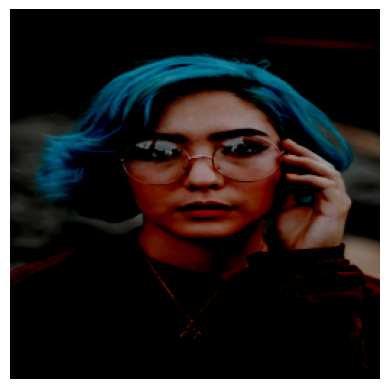

In [81]:
np = img_tensor.permute(1, 2, 0).numpy()
plt.imshow(np)
plt.axis('off')
plt.show()

In [82]:
result = [conv_layers[0](img_tensor)]

In [83]:
results = [conv_layers[0](img_tensor)]
for i in range(1,len(conv_layers)):
    results.append(conv_layers[i](results[-1]))

outputs = results

In [84]:
len(outputs)

6

In [85]:
outputs[0].shape

torch.Size([32, 256, 256])

### First Conv layer Feature Maps

Layer 1


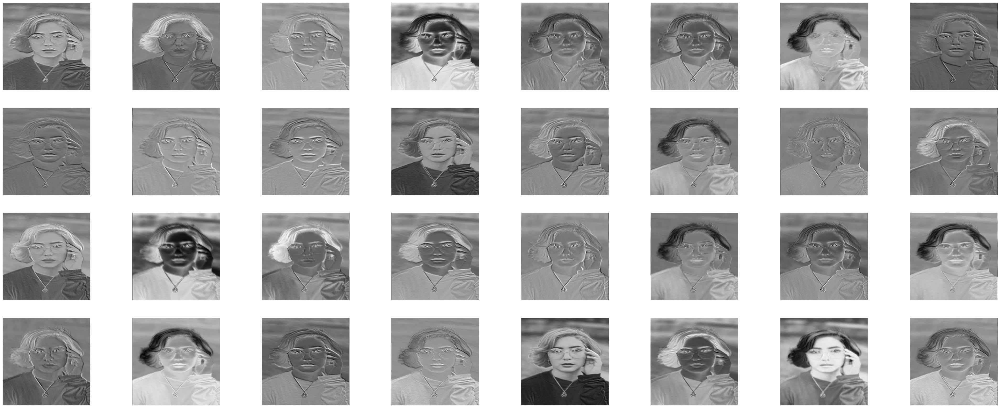

In [86]:
plt.figure(figsize=(50,20))
layer_viz = outputs[0].squeeze()
print("Layer",1)
for i, f in enumerate(layer_viz):
    plt.subplot(4,8,i+1)
    plt.imshow(f.detach().cpu().numpy(),cmap="gray")
    plt.axis('off')

plt.show()
plt.close()

### Second Conv Layer Feature Maps

Layer 2


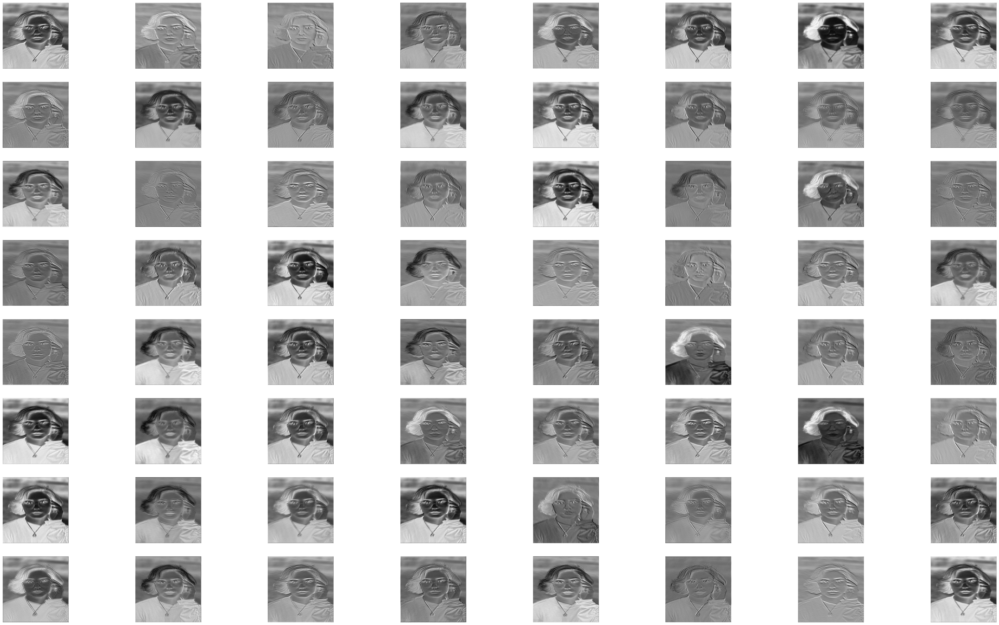

In [87]:
plt.figure(figsize=(50,30))
layer_viz = outputs[1].squeeze()
print("Layer",2)
for i, f in enumerate(layer_viz):
    plt.subplot(8,8,i+1)
    plt.imshow(f.detach().cpu().numpy(),cmap="gray")
    plt.axis('off')

plt.show()
plt.close()

In [ ]:
### Third Conv Layers F

Layer 3


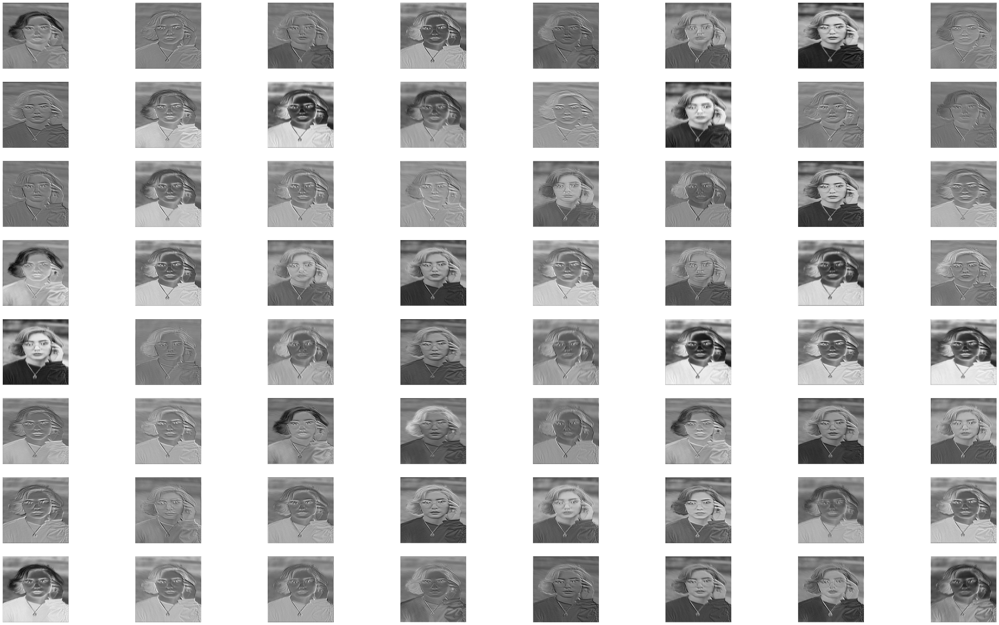

In [88]:
plt.figure(figsize=(50,30))
layer_viz = outputs[2].squeeze()
print("Layer",3)
for i, f in enumerate(layer_viz):
    plt.subplot(8,8,i+1)
    plt.imshow(f.detach().cpu().numpy(),cmap="gray")
    plt.axis('off')

plt.show()
plt.close()

Layer 3


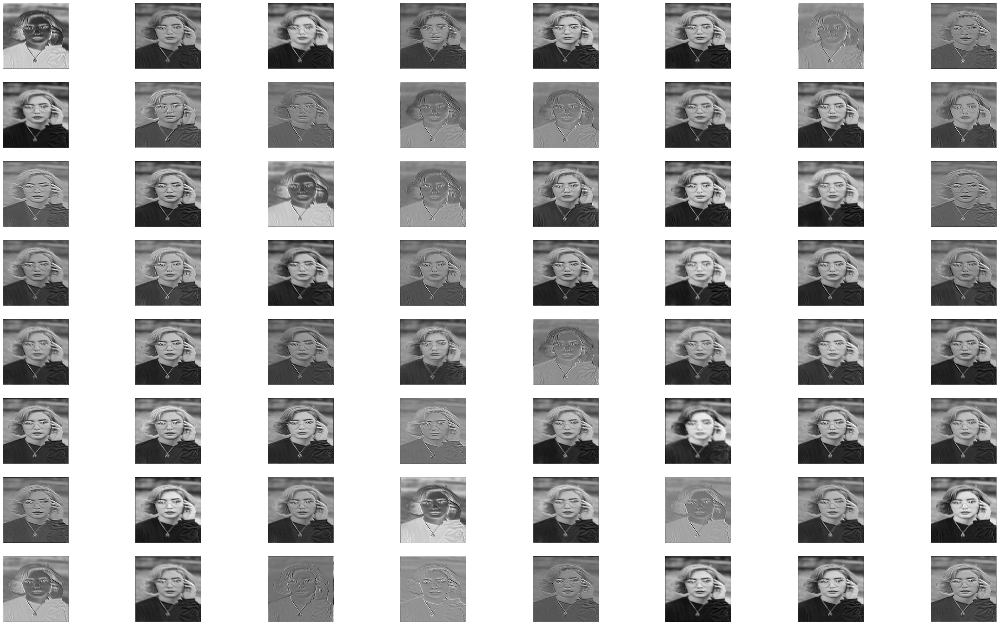

In [89]:
plt.figure(figsize=(50,30))
layer_viz = outputs[3].squeeze()
print("Layer",3)
for i, f in enumerate(layer_viz):
    plt.subplot(8,8,i+1)
    plt.imshow(f.detach().cpu().numpy(),cmap="gray")
    plt.axis('off')

plt.show()
plt.close()

Layer 3


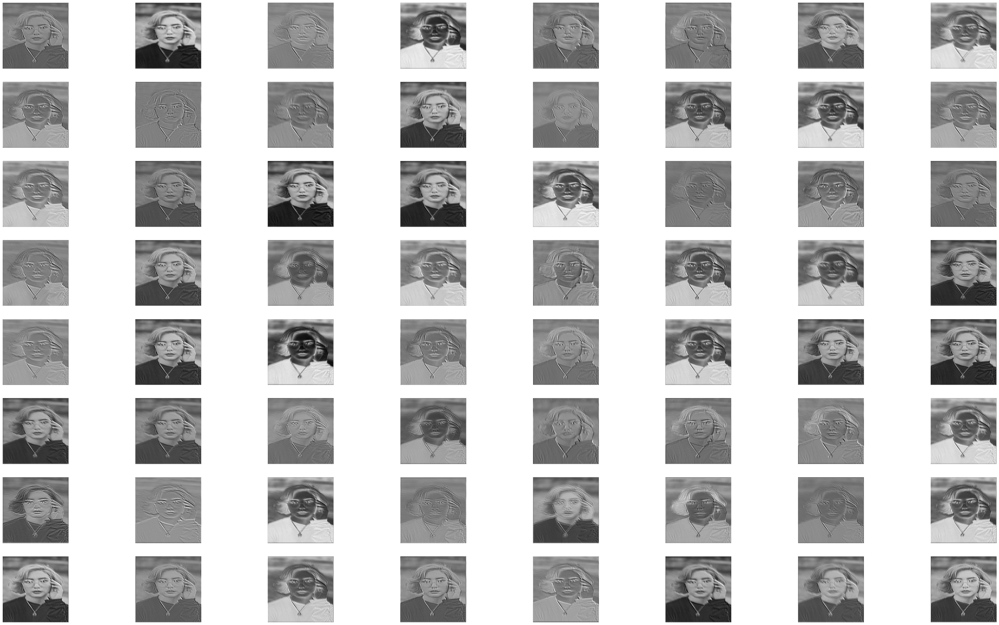

In [90]:
plt.figure(figsize=(50,30))
layer_viz = outputs[4].squeeze()
print("Layer",3)
for i, f in enumerate(layer_viz):
    plt.subplot(8,8,i+1)
    plt.imshow(f.detach().cpu().numpy(),cmap="gray")
    plt.axis('off')

plt.show()
plt.close()

Layer 4


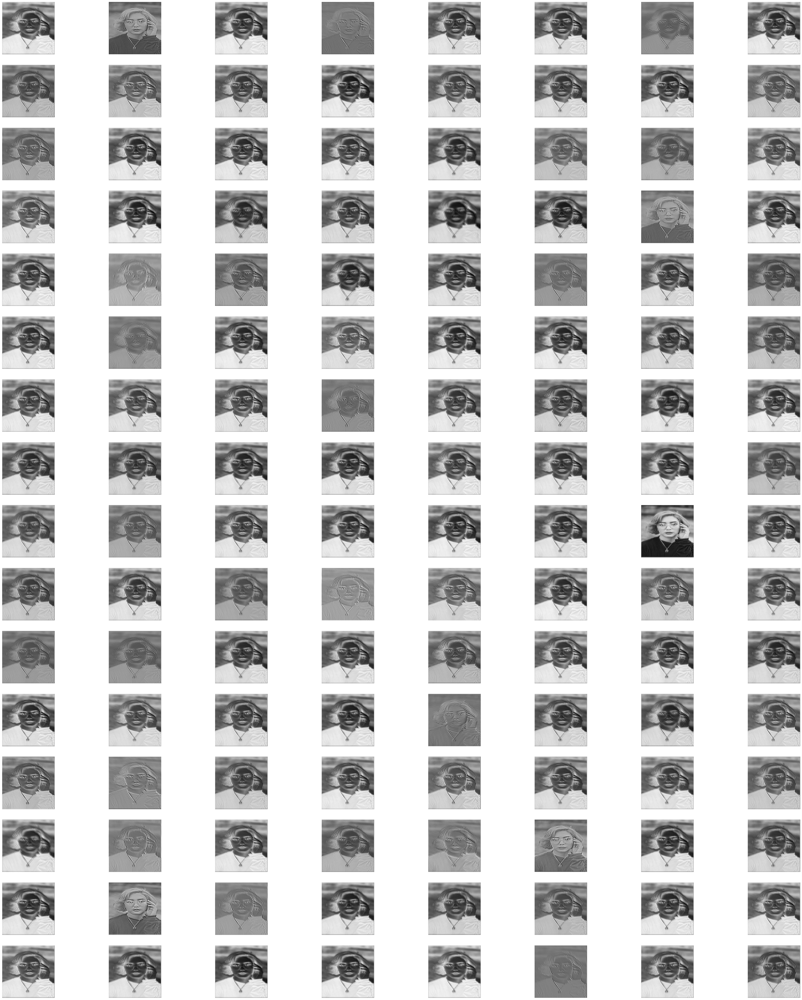

In [91]:
plt.figure(figsize=(50,60))
layer_viz = outputs[5].squeeze()
print("Layer",4)
for i, f in enumerate(layer_viz):
    plt.subplot(16,8,i+1)
    plt.imshow(f.detach().cpu().numpy(),cmap="gray")
    plt.axis('off')

plt.show()
plt.close()